## Plotting wavefront and intensity figure of light fileds

### Step 1: Imports modules

In [1]:
import SimLight as sl
import SimLight.zernike as slz
import SimLight.plottools as slpl

SimLight 0.1.2



### Step 2: Configures the units and parameters

In [2]:
# units
m = 1
cm = 1e-2
mm = 1e-3
µm = 1e-6
nm = 1e-9
# parameters
wavelength = 0.6328 * µm  # wavelength of laser
size = 20 * mm  # size of measured surface
f = 50 * mm  # focal length of lens
N = 500  # resolution
j = 15  # zernike orders to fit
labels = ['Defocus', 'Coma', 'Astigmatism', 'Spherical aberration']

### Step 3: Calculates the light field of defoucs, coma, astigmatism and spherical aberration

In [3]:
F0 = sl.PlaneWave(wavelength, size, N)
L = sl.Lens.new_lens(size, f)

In [4]:
coeffs = [[0.] * j for i in range(4)]
coeffs[0][4], coeffs[1][8], coeffs[2][5], coeffs[3][12] = .1, .1, .1, .1  # defoucs, coma, astigmatism, spherical aberration
Z = [slz.ZernikeCoefficients(j, coeffs[i]) for i in range(4)]

In [5]:
F = [sl.aberration(F0, Z[i]) for i in range(4)]

### Step 4: Plots the wavefront

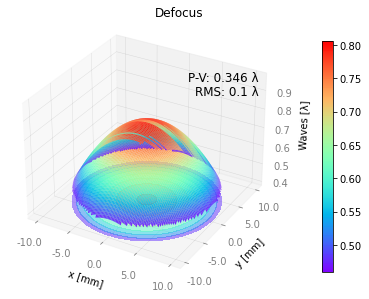

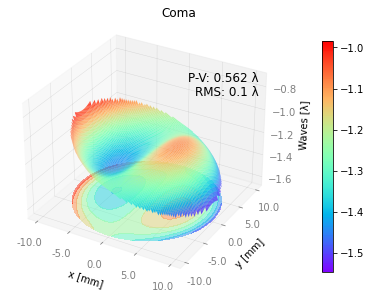

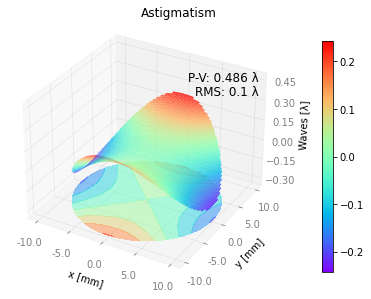

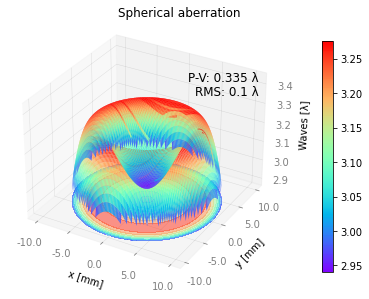

In [6]:
for i in range(4):
    slpl.plot_wavefront(F[i], mask_r=1, dimension=3, title=labels[i])

### Step 5: Plots the intensity

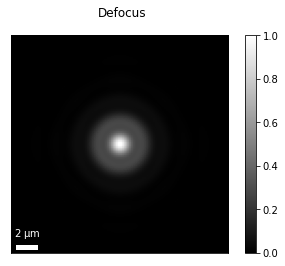

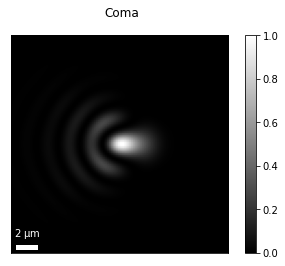

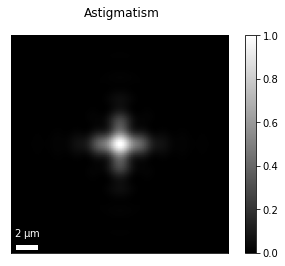

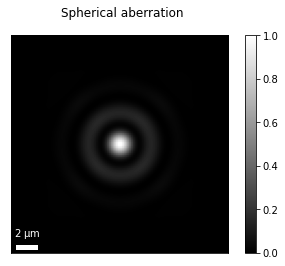

In [7]:
F = [sl.circle_aperture(F[i]) for i in range(4)]
F = [sl.near_field_propagation(F[i], L, z=f, coord='spherical') for i in range(4)]
for i in range(4):
    slpl.plot_intensity(F[i], norm_type=1 , title=labels[i], mag=1/5)

### Step 6: Shows the comparasion

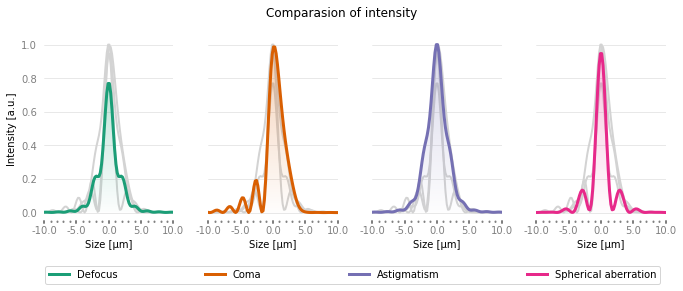

In [8]:
slpl.plot_multi_intensities_diff(*F, labels=labels, norm_type=1, figsize=(9.6, 3.6), ind=True, mag=1/5, title='Comparasion of intensity')